# Road accidents vs breath tests in the UK (2005 - 2014)

## Understanding the data
There are 2 datasets in this notebook. The first dataset contains all reported road accidents in the UK from 2005 - 2014 (except for 2008). It contains multiple columns, some of them are:   
    - **Longitude**  
    - **Latitude**       
    - **Speed limit**  
    - **Weather conditions**  
    - **Date**  
    - **Number of vehicles**  
    - **Number of casualties**  
    - **Road Type**  
    - **Did police officer attend scene of accident**    
      
The second dataset contains all roadside screening breath tests per year (2001 - 2017).  

## Importing modules

In [1]:
from pyspark import SparkConf, SparkContext
from pyspark.sql import SparkSession, Row
from pyspark.sql import SQLContext
from pyspark.sql.types import *
from pyspark.sql.functions import *
import matplotlib.pyplot as plt
from matplotlib import figure
import ipywidgets
from folium import plugins
from folium.plugins import HeatMap

## Create new Spark session

In [2]:
spark = SparkSession.builder \
   .master("local") \
   .appName("accidents") \
   .getOrCreate()
   
sc = spark.sparkContext
sqlContext = SQLContext(sc)
spark

## Make DF schemas

In [3]:

breath_tests_schema = StructType([
    StructField("Year", TimestampType(), nullable=True),
    StructField("Roadside screening breath tests", IntegerType(), nullable=True),
    StructField("Positive/refused breath tests", IntegerType(), nullable=True),
    StructField("Percentage", IntegerType(), nullable=True),
])


schema = StructType([
    StructField("Accident_Index", StringType(), nullable=True),
    StructField("Location_Easting_OSGR", IntegerType(), nullable=True),
    StructField("Location_Northing_OSGR", IntegerType(), nullable=True),
    StructField("Longitude", DoubleType(), nullable=True),
    StructField("Latitude", DoubleType(), nullable=True),
    StructField("Police_Force", IntegerType(), nullable=True),
    StructField("Accident_Severity", IntegerType(), nullable=True),
    StructField("Number_of_Vehicles", IntegerType(), nullable=True),
    StructField("Number_of_Casualties", IntegerType(), nullable=True),
    StructField("Date", StringType(), nullable=True),
    StructField("Day_of_Week", IntegerType(), nullable=True),
    StructField("Time", TimestampType(), nullable=True),
    StructField("Local_Authority_(District)", StringType(), nullable=True),
    StructField("Local_Authority_(Highway)", StringType(), nullable=True),
    StructField("1st_Road_Class", StringType(), nullable=True),
    StructField("1st_Road_Number", StringType(), nullable=True),
    StructField("Road_Type", StringType(), nullable=True),
    StructField("Speed_limit", IntegerType(), nullable=True),
    StructField("Junction_Detail", StringType(), nullable=True),
    StructField("Junction_Control", StringType(), nullable=True),
    StructField("2nd_Road_Class", StringType(), nullable=True),
    StructField("2nd_Road_Number", StringType(), nullable=True),
    StructField("Pedestrian_Crossing-Human_Control", StringType(), nullable=True),
    StructField("Pedestrian_Crossing-Physical_Facilities", StringType(), nullable=True),
    StructField("Light_Conditions", StringType(), nullable=True),
    StructField("Weather_Conditions", StringType(), nullable=True),
    StructField("Road_Surface_Conditions", StringType(), nullable=True),
    StructField("Special_Conditions_at_Site", StringType(), nullable=True),
    StructField("Carriageway_Hazards", StringType(), nullable=True),
    StructField("Urban_or_Rural_Area", StringType(), nullable=True),
    StructField("Did_Police_Officer_Attend_Scene_of_Accident", StringType(), nullable=True),
    StructField("LSOA_of_Accident_Location", StringType(), nullable=True),
    StructField("Year", IntegerType(), nullable=True)

])

## Import the datasets as Spark Dataframes

### Accidents dataset

In [4]:
first_df = spark.read.option("header", "true").csv(path="accidents_2005_to_2007.csv", schema=schema).cache()
second_df = spark.read.option("header", "true").csv(path="accidents_2009_to_2011.csv", schema=schema).cache()
third_df = spark.read.option("header", "true").csv(path="accidents_2012_to_2014.csv", schema=schema).cache()

df = first_df.union(second_df).union(third_df)

df = df.withColumn('Date', to_date(unix_timestamp(col('Date'), 'dd/MM/yyyy').cast("timestamp")))

df = df.withColumn("Month", date_format(col("Date"), "MM"))
df = df.withColumn("Day", date_format(col("Date"), "dd"))

df = df.withColumn('Did_Police_Officer_Attend_Scene_of_Accident', when(col('Did_Police_Officer_Attend_Scene_of_Accident') == "Yes", 
lit('1')).otherwise(0))
df = df.withColumn("Did_Police_Officer_Attend_Scene_of_Accident", df["Did_Police_Officer_Attend_Scene_of_Accident"].cast(IntegerType()))


### Breath tests dataset

In [5]:
breath_tests_df = spark.read.option("header", "true").csv(path="ras51016.csv", schema=breath_tests_schema).cache()

breath_tests_df = breath_tests_df.withColumn('Year', date_format(col('Year'), "yyyy"))


## Data exploration

### Road accidents dataset:  

In [6]:
df.select("Date", "Longitude", "Latitude", 'Number_of_Vehicles', "Road_Type", "Speed_limit", "Weather_Conditions", "Accident_Severity", "Did_Police_Officer_Attend_Scene_of_Accident").show(20, truncate=False)


+----------+---------+---------+------------------+------------------+-----------+--------------------------+-----------------+-------------------------------------------+
|Date      |Longitude|Latitude |Number_of_Vehicles|Road_Type         |Speed_limit|Weather_Conditions        |Accident_Severity|Did_Police_Officer_Attend_Scene_of_Accident|
+----------+---------+---------+------------------+------------------+-----------+--------------------------+-----------------+-------------------------------------------+
|2005-01-04|-0.19117 |51.489096|1                 |Single carriageway|30         |Raining without high winds|2                |1                                          |
|2005-01-05|-0.211708|51.520075|1                 |Dual carriageway  |30         |Fine without high winds   |3                |1                                          |
|2005-01-06|-0.206458|51.525301|2                 |Single carriageway|30         |Fine without high winds   |3                |1            

In [7]:
df.count()

1504150

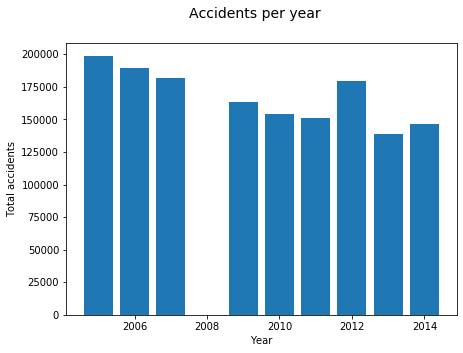

In [8]:
%matplotlib inline

x = []
y = []

count_per_year_df = df.groupby('Year').count()
count_per_year_df = count_per_year_df.sort(['Year'])

x = count_per_year_df.select('Year').rdd.map(lambda row : row[0]).collect()
y = count_per_year_df.select('count').rdd.map(lambda row : row[0]).collect()


fig1 = plt.figure(figsize=(7, 5))
fig1.suptitle('Accidents per year', fontsize=14)
ax = fig1.add_subplot(111)
ax.set_xlabel('Year')
ax.set_ylabel('Total accidents')
ax.bar(x, y, align='center')
plt.show()





+--------------------------+-------+
|Weather_Conditions        |count  |
+--------------------------+-------+
|null                      |126    |
|Snowing with high winds   |1960   |
|Fog or mist               |8190   |
|Snowing without high winds|11301  |
|Fine with high winds      |18355  |
|Raining with high winds   |20813  |
|Unknown                   |28296  |
|Other                     |33503  |
|Raining without high winds|177663 |
|Fine without high winds   |1203943|
+--------------------------+-------+



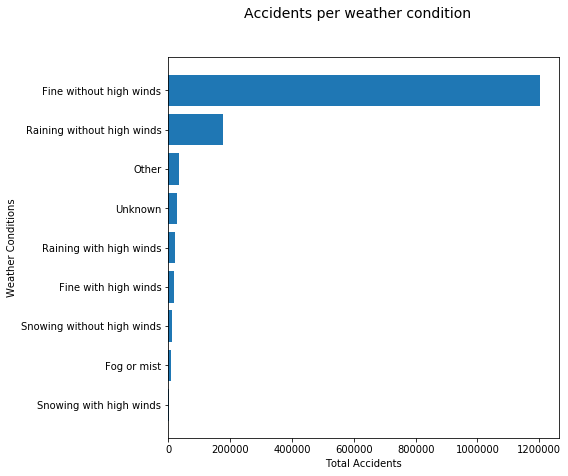

In [9]:

weather_count_df = df.groupBy("Weather_Conditions").count().sort(["count"])
weather_count_df.show(truncate=False)
weather_count_df = weather_count_df.na.drop()

x = weather_count_df.select('Weather_Conditions').rdd.map(lambda row: row[0]).collect()
y = weather_count_df.select('count').rdd.map(lambda row: row[0]).collect()

fig1 = plt.figure(figsize=(7, 7))
fig1.suptitle('Accidents per weather condition', fontsize=14)
ax = fig1.add_subplot(111)
ax.set_xlabel('Total Accidents')
ax.set_ylabel('Weather Conditions')
ax.barh(x, y)
plt.show()


+-----------+------+
|Speed_limit| count|
+-----------+------+
|         10|    14|
|         15|    10|
|         20| 17157|
|         30|968284|
|         40|122393|
|         50| 48790|
|         60|238234|
|         70|109268|
+-----------+------+



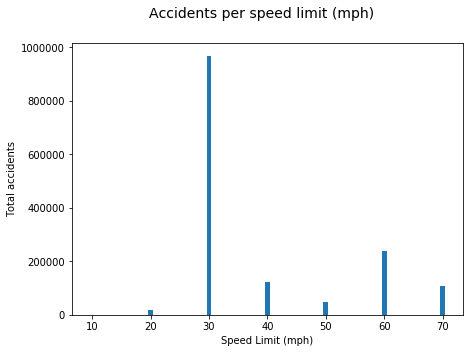

In [10]:
%matplotlib inline

x = []
y = []

speed_limit_count_df = df.groupBy('Speed_limit').count()
speed_limit_count_df = speed_limit_count_df.sort(["Speed_limit"])
speed_limit_count_df.show()

x = speed_limit_count_df.select('Speed_limit').rdd.map(lambda row: row[0]).collect()
y = speed_limit_count_df.select('count').rdd.map(lambda row: row[0]).collect()

fig1 = plt.figure(figsize=(7, 5))
fig1.suptitle('Accidents per speed limit (mph)', fontsize=14)
ax = fig1.add_subplot(111)
ax.set_xlabel('Speed Limit (mph)')
ax.set_ylabel('Total accidents')
ax.bar(x, y, align='center')
plt.show()



In [11]:
weather_array = df.select("Road_Type").distinct().rdd.map(lambda row : row[0]).collect()

road_dropdown = ipywidgets.Dropdown(
    options= weather_array,
    description='Road type:',
    disabled=False,
)
road_dropdown

Dropdown(description='Road type:', options=('Slip road', 'One way street', 'Unknown', 'Roundabout', 'Single ca…

In [12]:

selected_road_df = df.filter(df.Road_Type == road_dropdown.value)
vehicles_per_year_per_road = selected_road_df.groupBy("Year").mean("Did_Police_Officer_Attend_Scene_of_Accident").sort(["Year"])

vehicles_per_year_per_road.show()



+----+------------------------------------------------+
|Year|avg(Did_Police_Officer_Attend_Scene_of_Accident)|
+----+------------------------------------------------+
|2005|                              0.7772126144455748|
|2006|                              0.7730460921843687|
|2007|                              0.8034447821681864|
|2009|                              0.7950530035335689|
|2010|                              0.8057726999398677|
|2011|                               0.810880829015544|
|2012|                              0.8259935553168636|
|2013|                              0.8172874209416725|
|2014|                               0.833981841763943|
+----+------------------------------------------------+



In [13]:
speed_limit_dropdown = df.select("Speed_limit").distinct().sort(["Speed_limit"]).rdd.map(lambda row : row[0]).collect()

speed_dropdown = ipywidgets.Dropdown(
    options= speed_limit_dropdown,
    description='Speed:',
    disabled=False,
)
max_vehicles = df.select(max(df.Number_of_Vehicles)).collect()[0][0]

vehicles_slider = ipywidgets.IntSlider(
    value=1,
    min=1,
    max=max_vehicles,
    step=1,
    description='#Vehicles:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

w_box = ipywidgets.Box(children = [speed_dropdown,vehicles_slider])
w_box

Box(children=(Dropdown(description='Speed:', options=(10, 15, 20, 30, 40, 50, 60, 70), value=10), IntSlider(va…

In [14]:
df_speed_vehicles = df.select("Date", "Longitude", "Latitude", "Speed_limit", "Number_of_Vehicles", "Number_of_Casualties").filter(df.Speed_limit == speed_dropdown.value).filter(df.Number_of_Vehicles >= vehicles_slider.value)

print("Number of accidents: " + str(df_speed_vehicles.count()))
print("Max vehicles with this speed limit: " + str(df.filter(df.Speed_limit == speed_dropdown.value).select(max(df.Number_of_Vehicles)).collect()[0][0]))
print("Max casualties with this speed limit: " + str(df.filter(df.Speed_limit == speed_dropdown.value).select(max(df.Number_of_Casualties)).collect()[0][0]))
df_speed_vehicles.sort(col("Number_of_Casualties").desc()).show(100)


Number of accidents: 14
Max vehicles with this speed limit: 3
Max casualties with this speed limit: 2
+----------+---------+---------+-----------+------------------+--------------------+
|      Date|Longitude| Latitude|Speed_limit|Number_of_Vehicles|Number_of_Casualties|
+----------+---------+---------+-----------+------------------+--------------------+
|2007-11-22|-3.031866|56.484055|         10|                 1|                   2|
|2005-10-15|-0.499242|52.027746|         10|                 3|                   2|
|2010-11-05|-2.957903|58.984499|         10|                 1|                   2|
|2005-10-01|-2.632396|53.652591|         10|                 1|                   1|
|2005-11-24|-4.667894|55.615657|         10|                 2|                   1|
|2005-12-30|-2.959071|58.982694|         10|                 1|                   1|
|2007-07-09|-6.372073|57.584914|         10|                 1|                   1|
|2005-01-17|  -3.6481|55.085658|         10|    

In [15]:
year_select = df.select("Year").distinct().sort(["Year"]).rdd.map(lambda row : row[0]).collect()

year_select_widget = ipywidgets.SelectMultiple(
    options= year_select,
    #rows=10,
    description='Years',
    disabled=False
)
year_select_widget




SelectMultiple(description='Years', options=(2005, 2006, 2007, 2009, 2010, 2011, 2012, 2013, 2014), value=())

No handles with labels found to put in legend.


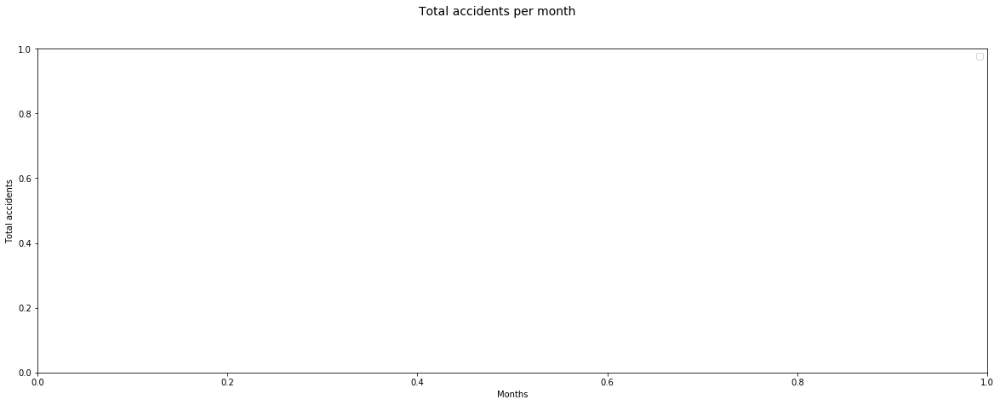

In [16]:
count_per_month_df = df.groupby('Month', 'Year').count().sort(["Month"])


x = []
y = []
years_widget = []

for i in range(len(year_select_widget.value)):
    years_widget.append(year_select_widget.value[i])


fig1 = plt.figure(figsize=(20, 7))
fig1.suptitle('Total accidents per month', fontsize=14)
ax = fig1.add_subplot(111)
ax.set_xlabel('Months')
ax.set_ylabel('Total accidents')

x = count_per_month_df.select("Month").distinct().sort(["Month"]).rdd.map(lambda row: row[0]).collect()

years_df = count_per_month_df.filter(count_per_month_df.Year.isin(years_widget)).sort(["Month"])

for i in range(len(years_widget)):
    y = years_df.filter(years_df.Year == years_widget[i]).select("count").rdd.map(lambda row: row[0]).collect()
    plt.plot(x, y, label = years_widget[i])
   
plt.legend()    

In [17]:
mean_per_day = df.groupby('Year').count().sort(["Year"])
mean_per_day = mean_per_day.withColumn('count per day', (col('count') / 365))
mean_per_day.show()

+----+------+------------------+
|Year| count|     count per day|
+----+------+------------------+
|2005|198735| 544.4794520547945|
|2006|189161| 518.2493150684932|
|2007|182115|498.94520547945206|
|2009|163554| 448.0931506849315|
|2010|154414|423.05205479452053|
|2011|151474| 414.9972602739726|
|2012|179715|492.36986301369865|
|2013|138660| 379.8904109589041|
|2014|146322| 400.8821917808219|
+----+------+------------------+



In [18]:
coordinates_df = df.select("Latitude", "Longitude")
coordinates_df = coordinates_df.na.drop()


In [19]:
import folium

accidents_map = folium.Map(location=[55.509865, -0.118092], zoom_start = 6) 

coordinates = coordinates_df.rdd.map(lambda row : [row[0], row[1]]).collect()

HeatMap(coordinates, radius = 11).add_to(accidents_map)
accidents_map



### Roadside screening breath tests dataset:

In [20]:
breath_tests_df.show()

+----+-------------------------------+-----------------------------+----------+
|Year|Roadside screening breath tests|Positive/refused breath tests|Percentage|
+----+-------------------------------+-----------------------------+----------+
|2001|                         624000|                       100000|        16|
|2002|                         570000|                       103000|        18|
|2003|                         534000|                       106000|        20|
|2004|                         578000|                       103000|        18|
|2005|                         607000|                       104000|        17|
|2006|                         602000|                       104000|        17|
|2007|                         600000|                        98000|        16|
|2008|                         712000|                        92000|        13|
|2009|                         815000|                        93000|        11|
|2010|                         737000|  

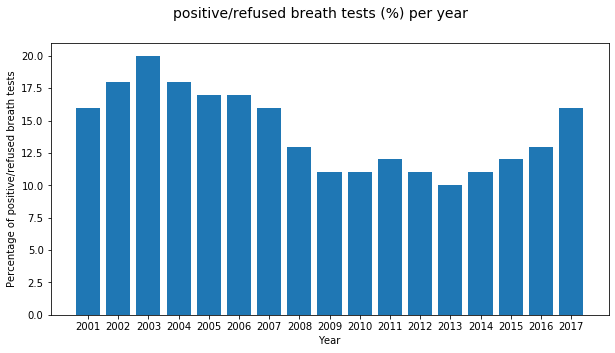

In [21]:
%matplotlib inline

x = []
y = []

range_length = breath_tests_df.count()

for i in range(range_length):
    x.append(breath_tests_df.select('Year').collect()[i][0])

for i in range(range_length):
    y.append(breath_tests_df.select('Percentage').collect()[i][0])

fig1 = plt.figure(figsize=(10, 5))
fig1.suptitle('positive/refused breath tests (%) per year', fontsize=14)
ax = fig1.add_subplot(111)
ax.set_xlabel('Year')
ax.set_ylabel('Percentage of positive/refused breath tests')
ax.bar(x, y, align='center')
plt.show()

### Combined:

+----+-------------------------------+-----------------------------+----------+------+-----------------+
|Year|Roadside screening breath tests|Positive/refused breath tests|Percentage| count|Percentage * 2000|
+----+-------------------------------+-----------------------------+----------+------+-----------------+
|2005|                         607000|                       104000|        17|198735|            34000|
|2006|                         602000|                       104000|        17|189161|            34000|
|2007|                         600000|                        98000|        16|182115|            32000|
|2009|                         815000|                        93000|        11|163554|            22000|
|2010|                         737000|                        84000|        11|154414|            22000|
|2011|                         686000|                        81000|        12|151474|            24000|
|2012|                         686000|                 

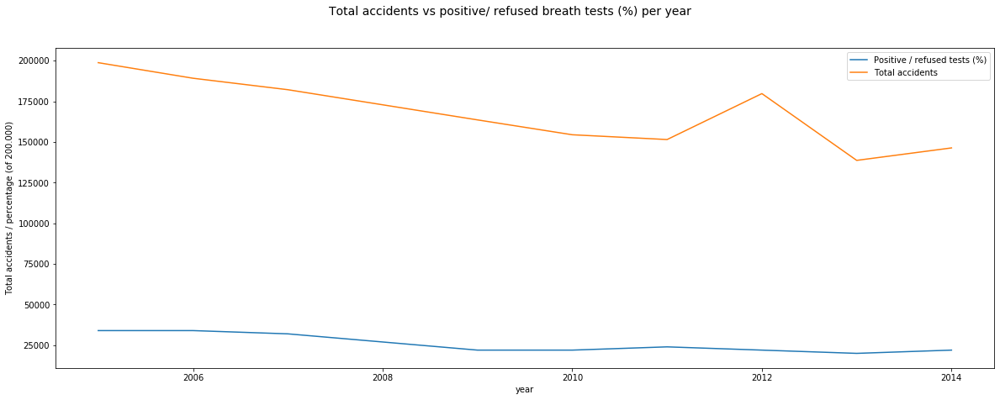

In [22]:
%matplotlib inline

filtered_breath_tests_df = breath_tests_df.filter(breath_tests_df.Year > 2004).filter(breath_tests_df.Year < 2015).sort(["Year"])

combined_df = filtered_breath_tests_df.join(count_per_year_df, "Year", "right").sort(["Year"])
combined_df = combined_df.withColumn('Percentage * 2000', (col('Percentage') * 2000))
combined_df.show()

x = []
y_percentage = []
y_count = []
range_length = combined_df.count()

x = combined_df.select('Year').rdd.map(lambda row: row[0]).collect()
y_percentage = combined_df.select('Percentage * 2000').rdd.map(lambda row: row[0]).collect()
y_count = combined_df.select('count').rdd.map(lambda row: row[0]).collect()


fig1 = plt.figure(figsize=(20, 7))
fig1.suptitle('Total accidents vs positive/ refused breath tests (%) per year', fontsize=14)
ax = fig1.add_subplot(111)
ax.set_xlabel('year')
ax.set_ylabel('Total accidents / percentage (of 200.000)')

p1 = plt.plot(x, y_percentage)
p2 = plt.plot(x, y_count)

plt.legend((p1[0], p2[0]), ("Positive / refused tests (%)", "Total accidents"))
